# Sprawozdanie 1
Analiza i przetwarzanie obrazów <br>
Tomasz Maczek, grupa 3 (piątek 10:30), 2022/2023, WFiIS

In [1]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams['font.size'] = 16

# Laboratorium 4

**a) Proszę wczytać przykładowy obraz (pierwszy z laboratorium 3).**

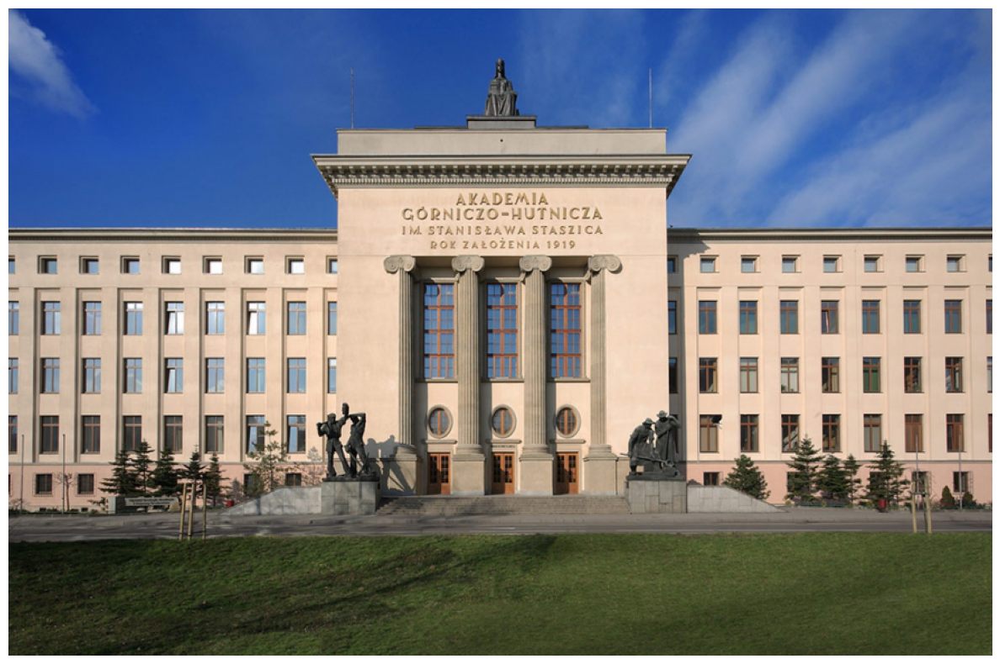

In [2]:
image = cv2.imread("lab3_1.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.imshow(image)
plt.axis('off')
plt.show()

**b) Proszę sprawdzić i porównać wynik następującej operacji: zmniejszania rozmiaru obrazu
o 50 % - jedną z wybranych metod - a następnie zwiększenie o 50% z użyciem wszystkich
dostępnych w OpenCV metod interpolacji. Proszę porównać uzyskany wynik z obrazem
pierwotnym**

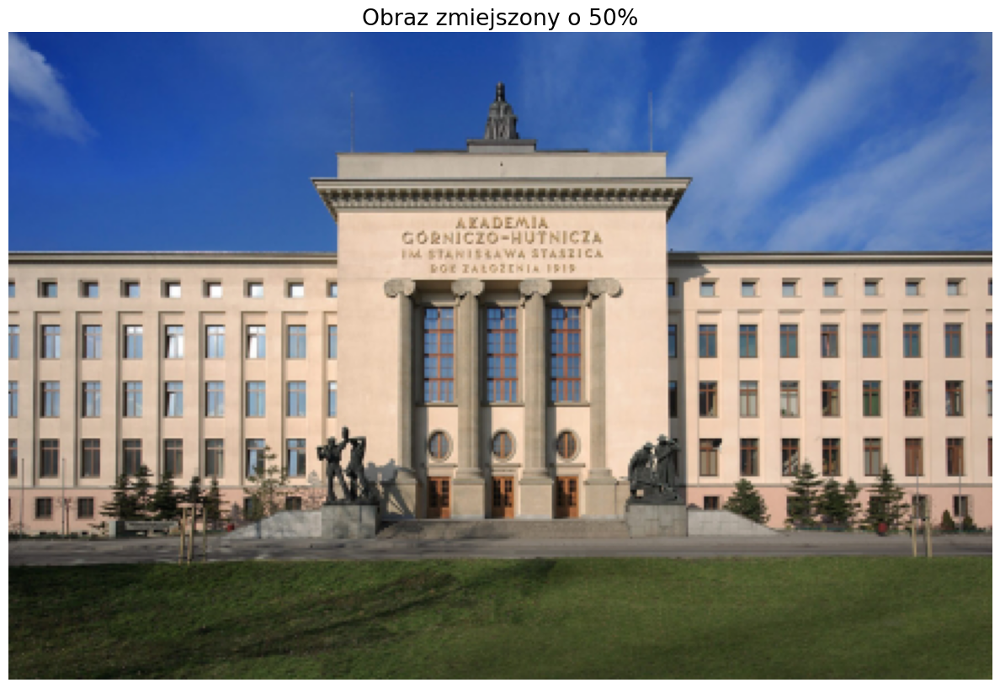

Wymiary oryginału: 580 x 880
Wymiary zmienjszonego: 290 x 440


In [3]:
#zmniejszenie obrazu o 50%
 
scale = 50 
width = int(image.shape[1] * scale / 100)
height = int(image.shape[0] * scale / 100)
dim = (width, height)

half_size = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)

plt.imshow(half_size)
plt.axis('off')
plt.title('Obraz zmiejszony o 50%')
plt.show()

print('Wymiary oryginału: ' + str(image.shape[0]) + ' x ' + str(image.shape[1]))
print('Wymiary zmienjszonego: ' + str(half_size.shape[0]) + ' x ' + str(half_size.shape[1]))

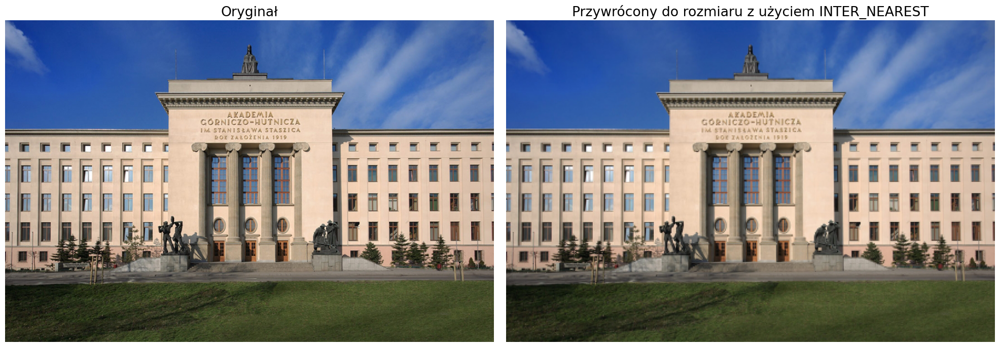

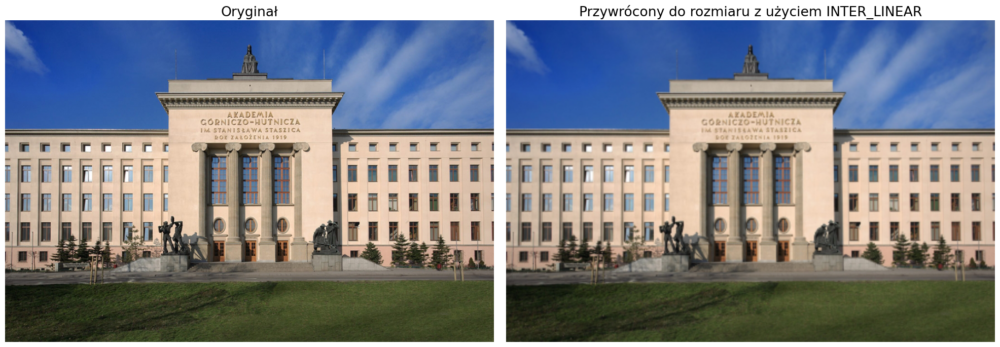

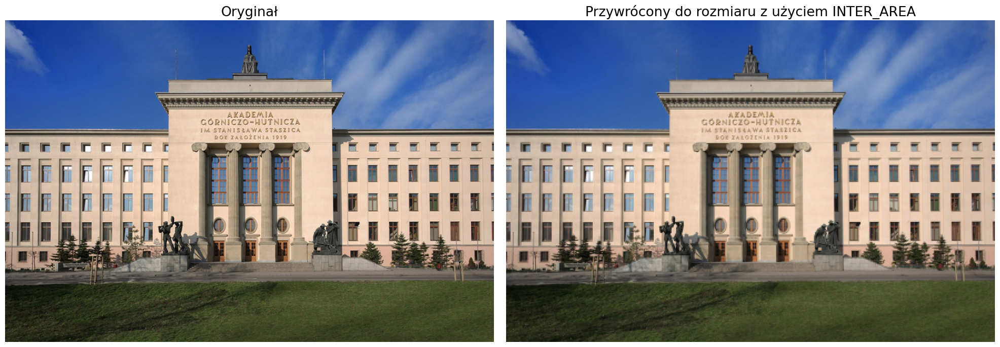

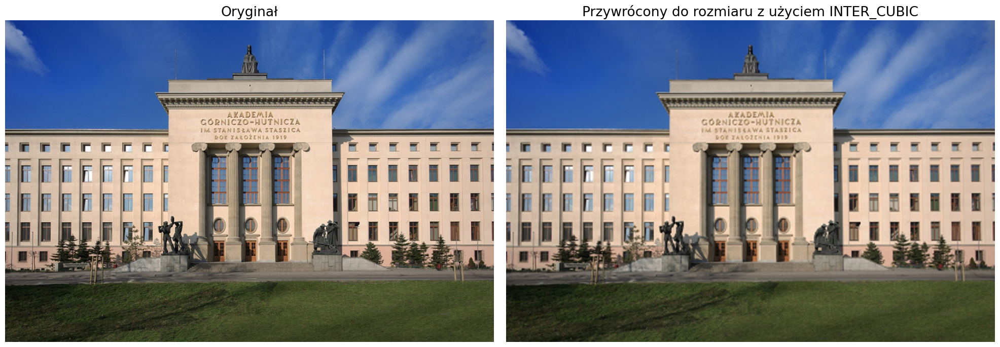

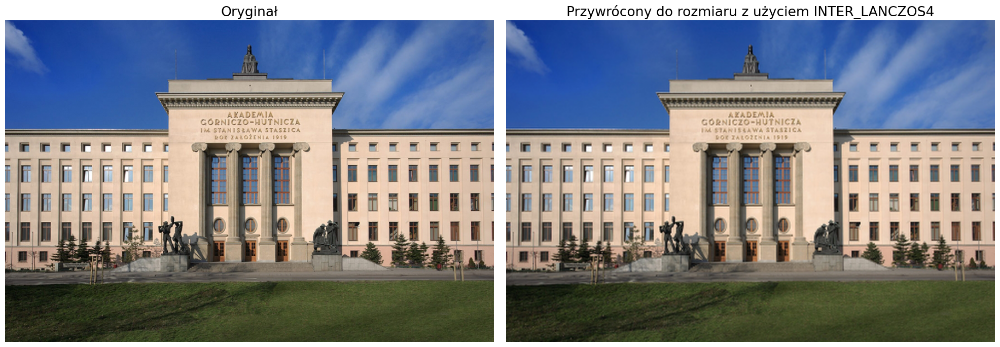

In [4]:
# ponownie do pelnego rozmiaru z wszystkimi interpolacjami

scale = 200
width = int(image.shape[1] * scale / 100)
height = int(image.shape[0] * scale / 100)
dim = (width, height)



titles = ['INTER_NEAREST', 'INTER_LINEAR', 'INTER_AREA','INTER_CUBIC', 'INTER_LANCZOS4']
methods = [cv2.INTER_NEAREST, cv2.INTER_LINEAR, cv2.INTER_AREA, cv2.INTER_CUBIC, cv2.INTER_LANCZOS4]

rows = len(methods)

for i in range(rows):
    inter = cv2.resize(half_size, dim, interpolation = methods[i])
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Oryginał')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(inter)
    plt.title('Przywrócony do rozmiaru z użyciem ' + titles[i] )
    plt.axis('off')
    plt.tight_layout()
    plt.show()


Zmianę rozmiaru obrazu wykonywaliśmy za pomocą **cv.resize**. Przyjmuje ona jako argumenty obraz, wymiary jakie ma przyjąć oraz rodzaj interpolacji - jest ona szczególnie istotna przy powiększaniu obrazu, ponieważ muszą zostać wygenerowane dodatkowe piksele aby osiągnąć większy rozmiar. Przetestowane tu metody interpolacji to:

- cv2.INTER_NEAREST – najbliższy sąsiad
- cv2.INTER_LINEAR – liniowa
- cv2.INTER_AREA – próbkowanie na podstawie obszaru
- cv2.INTER_CUBIC – interpolacja sześcienna (bicubic interpolation),
- cv2.INTER_LANCZOS4 – interpolacja sinusoidalna (sinusoidal interpolation).

W każdym wypadku oczywiście nie otrzymaliśmy tak dobrego obrazu jak oryginał. W metodach **nearest**, **linear** oraz **area**
widzimy dość znaczne 'pikselowanie'. Dla **cubic** oraz **lanczos4** nie jest ono tak wyraźne, ale wciąż widać że obraz przeszedł przez zmianę rozmiarów. W dwóch ostatnich można zauważyć jak mniejsze obiekty zostają 'pochłonięte' przez większe tło - przykładem jest pierwsza rzeźba po lewej, gdzie ciemny kształt głowy jest nieco mniejszy niż w oryginale.


**c) Proszę nałożyć na obraz filtr uśredniający o macierzy K w rozmiarze 5x5, 10x10 i 15x15.
Jaki efekt został zaobserwowany?**

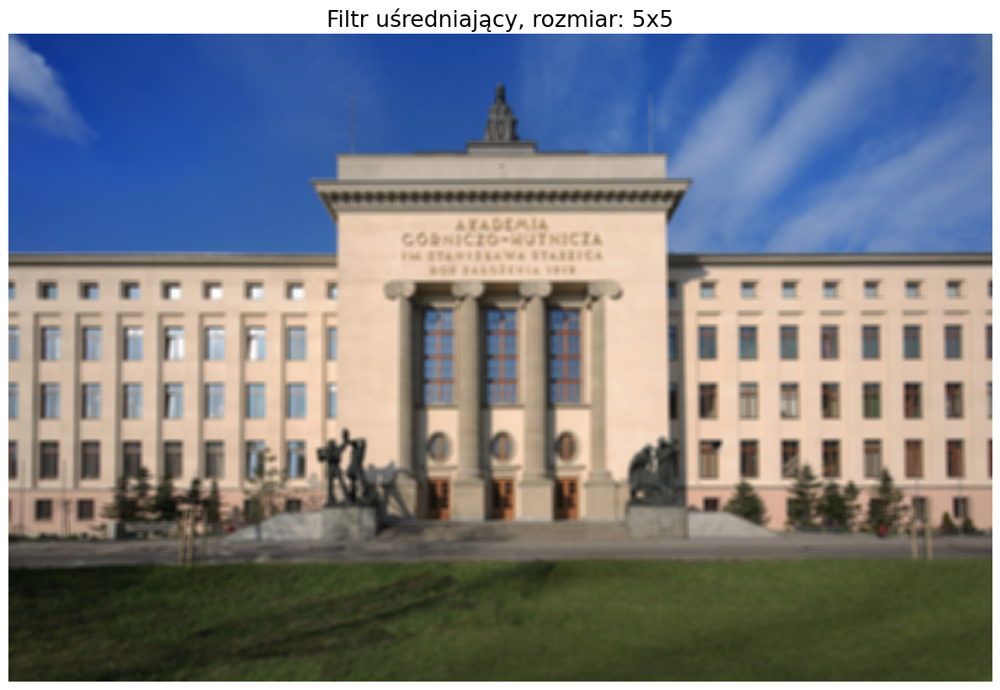

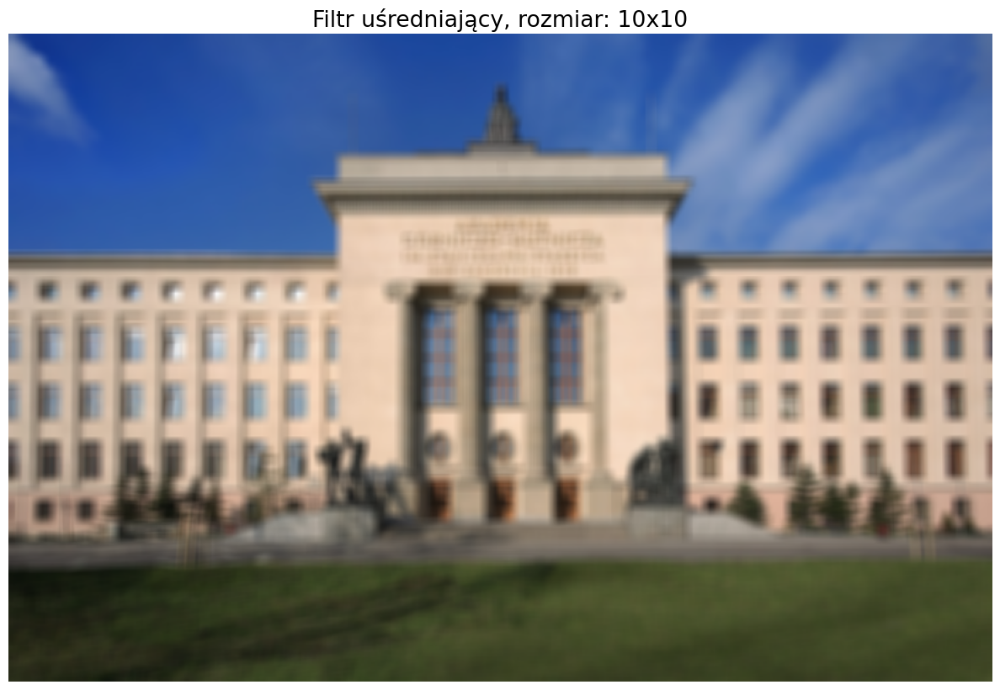

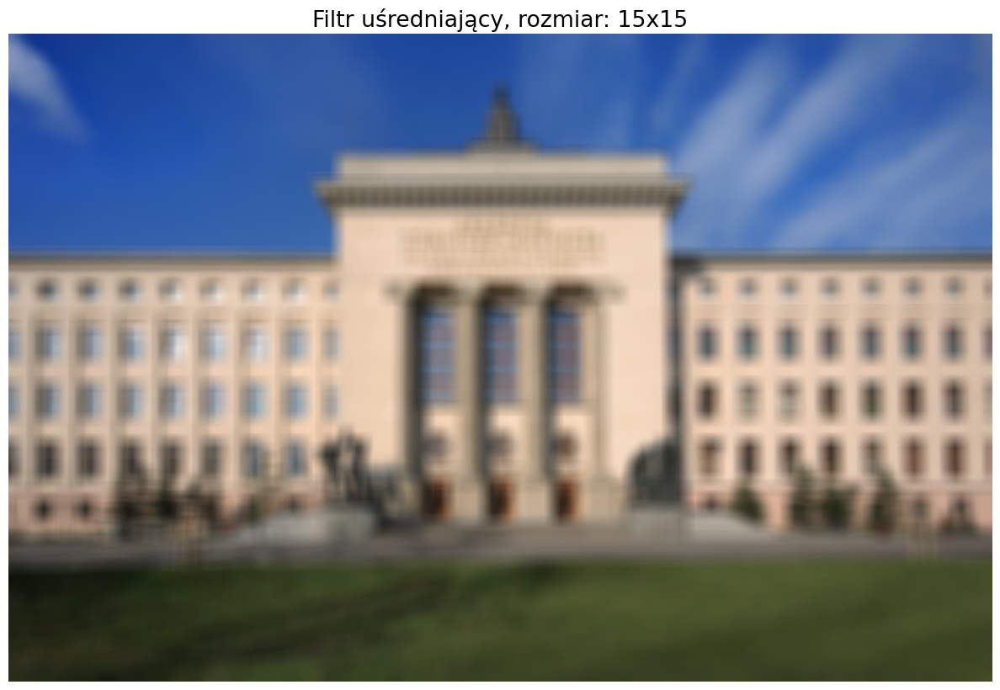

In [5]:
sizes = [5, 10, 15]

for size in sizes:
    ksize = (size, size)
    with_filtr = cv2.blur(image, ksize)
    
    plt.imshow(with_filtr)
    plt.title('Filtr uśredniający, rozmiar: ' + str(size) + 'x' + str(size))
    plt.axis('off')
    plt.show()

Filtr uśredniający realizowany jest za pomocą funkcji **cv2.blur**. Pomaga on w usuwaniu szumu i rozmywaniu krawędzi na obrazie.  Wartość piksela jest obliczana na postawie średniej z wartości sąsiadów, ilu sąsiadów bierzemy pod uwagę przekazujemy jako rozmiar filtra. Dla naszego obrazu widzimy rozmycie napisu na fasadzie budynku oraz ujednolicenie odcieni zieleni trawy, co może być przydatne przy kolejnych operacjach na obrazie.

**d) Proszę nałożyć na obraz filtr medianowy o rozmiarze 5x5, 11x11 i 15x15. Jaki efekt został
zaobserwowany?**

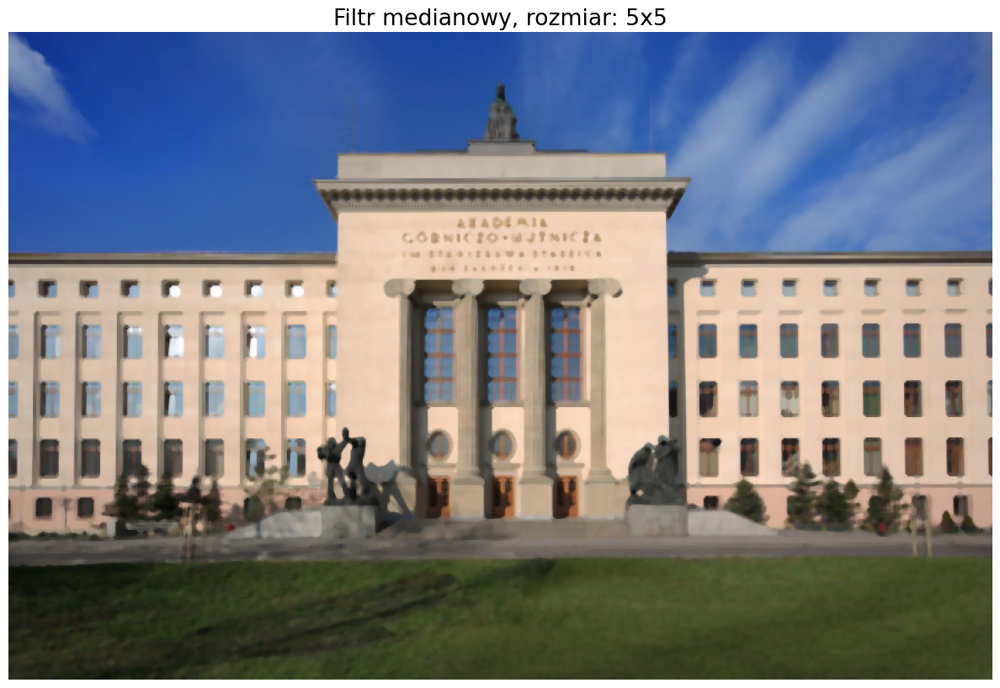

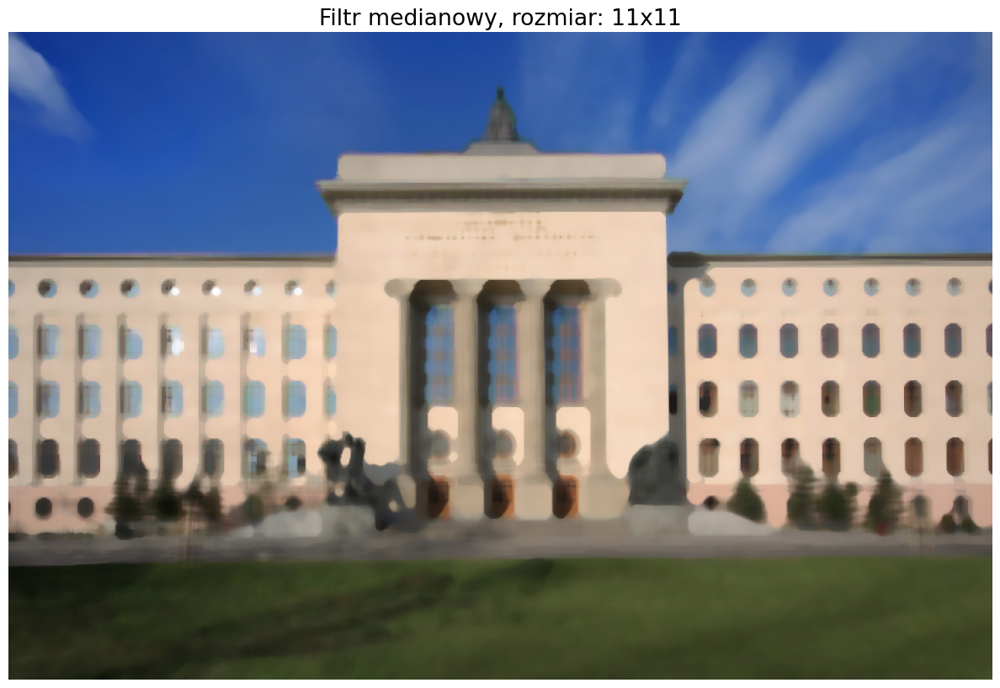

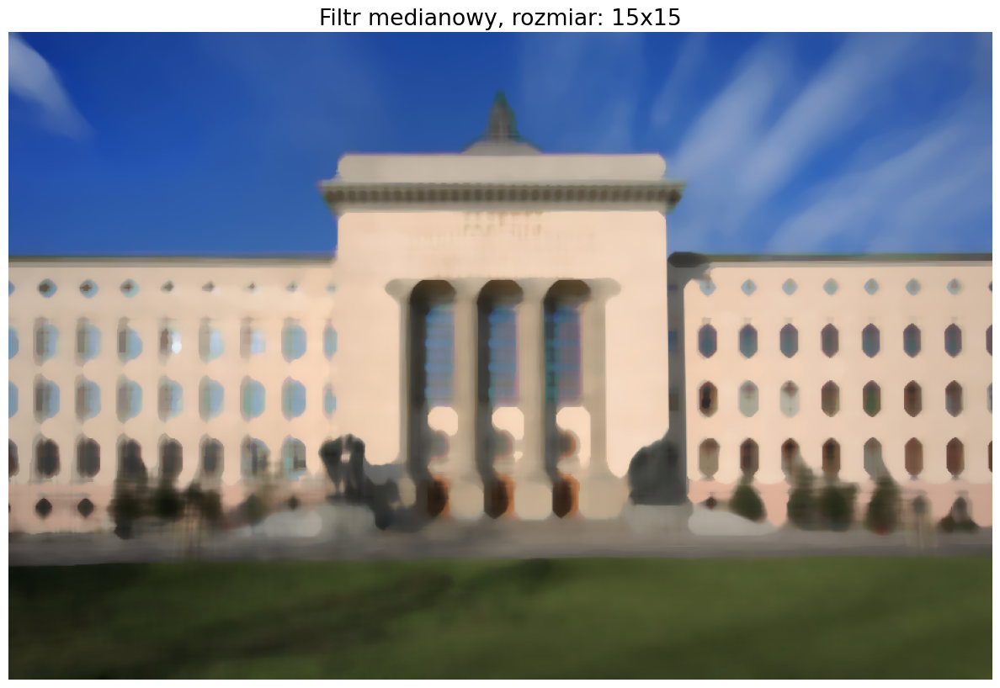

In [6]:
sizes = [5, 11, 15]

for size in sizes:
    with_filtr = cv2.medianBlur(image, size)
    
    plt.imshow(with_filtr)
    plt.title('Filtr medianowy, rozmiar: ' + str(size) + 'x' + str(size))
    plt.axis('off')
    plt.show()

Filtr medianowy realizowany jest za pomocą **cv2.medianBlur**. Centralny piksel będzie zastąpiony przez wartość mediany z jego sąsiedztwa. Filtr ten jest wysoce skuteczny do usuwania szumu typu 'salt and pepper' z obrazu. Wartość rozmiaru kernela w tym wypadku musi być zawsze nieparzysta. <br>

Na rozważanym obrazie widzimy, że filtr ten między innymi zaokrągla kąty okien i budynku jak również usuwa małe/cienkie elementy z obrazu (szprosy w oknach).

**e) Proszę nałożyć na obraz filtr gaussowski (o rozmiarze 5) i zaobserwować uzyskane
wyniki.**

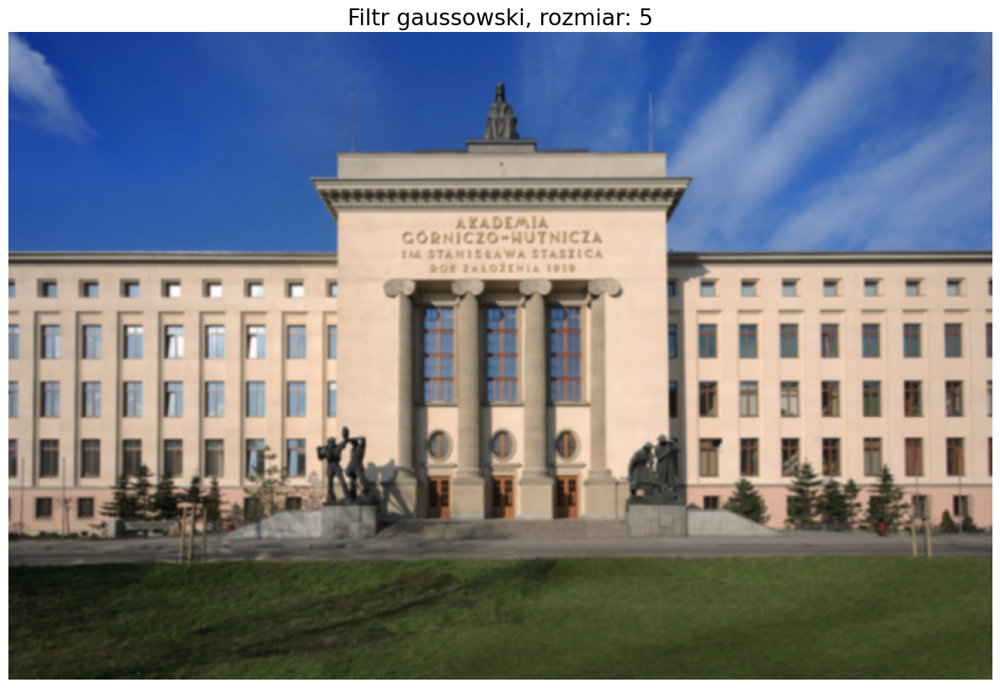

In [7]:
with_gaussian = cv2.GaussianBlur(image, (5, 5), 0)
    
plt.imshow(with_gaussian)
plt.title('Filtr gaussowski, rozmiar: 5')
plt.axis('off')
plt.show()

Filtr gaussowski realizowany jest funkcją **cv2.GaussianBlur**. Używa ona jądra gaussowskiego o podanym rozmiarze. W porównaniu do oryginalnego obrazu i poprzednich dwóch filtrów o rozmiarze 5, filtr gaussowski rozmył nieco krawędzie na obrazie, jednak elementy są wciąż wyraźne dla ludzkiego oka (jak napis na fasadzie, kształt drzew i rzeźb). Filtr ten jest szczególnie użyteczny do usuwania gaussowskiego szumu z obrazu.

**f) Proszę zbinaryzować obraz po przefiltrowaniu go powyższymi metodami i porównać do
binaryzacji bez filtracji**

In [8]:
#funkcja przyjmuje obraz, rozmiar kernela i poziom progrowania i rysuje obrazy po filtrowaniu i binaryzacji
def binary_filters(image, size, thresh_level):
    max_level = 255
    blur = cv2.blur(image, (size, size))
    median_blur = cv2.medianBlur(image, size)
    gaussian_blur = cv2.GaussianBlur(image, (size, size), 0)

    image_bin = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    blur_bin = cv2.cvtColor(blur, cv2.COLOR_RGB2GRAY)
    median_bin = cv2.cvtColor(median_blur, cv2.COLOR_RGB2GRAY)
    gaussian_bin = cv2.cvtColor(gaussian_blur, cv2.COLOR_RGB2GRAY)

    _, image_bin = cv2.threshold(image_bin, thresh_level, max_level, cv2.THRESH_BINARY)
    _, blur_bin = cv2.threshold(blur_bin, thresh_level, max_level, cv2.THRESH_BINARY)
    _, median_bin = cv2.threshold(median_bin, thresh_level, max_level, cv2.THRESH_BINARY)
    _, gaussian_bin = cv2.threshold(gaussian_bin, thresh_level, max_level, cv2.THRESH_BINARY)

    images = [image_bin, blur_bin, median_bin, gaussian_bin]
    titles = ['Oryginał', 'Filtr uśredniający', 'Filtr medianowy', 'Filtr gaussowski']

    items_len = len(images)
    for i in range(items_len):
        plt.subplot(2, 2, i+1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')

    plt.suptitle('Rozmiar kernela dla filtrów: ' + str(size) +  ', poziom progu: ' + str(thresh_level))
    plt.tight_layout()
    plt.show()

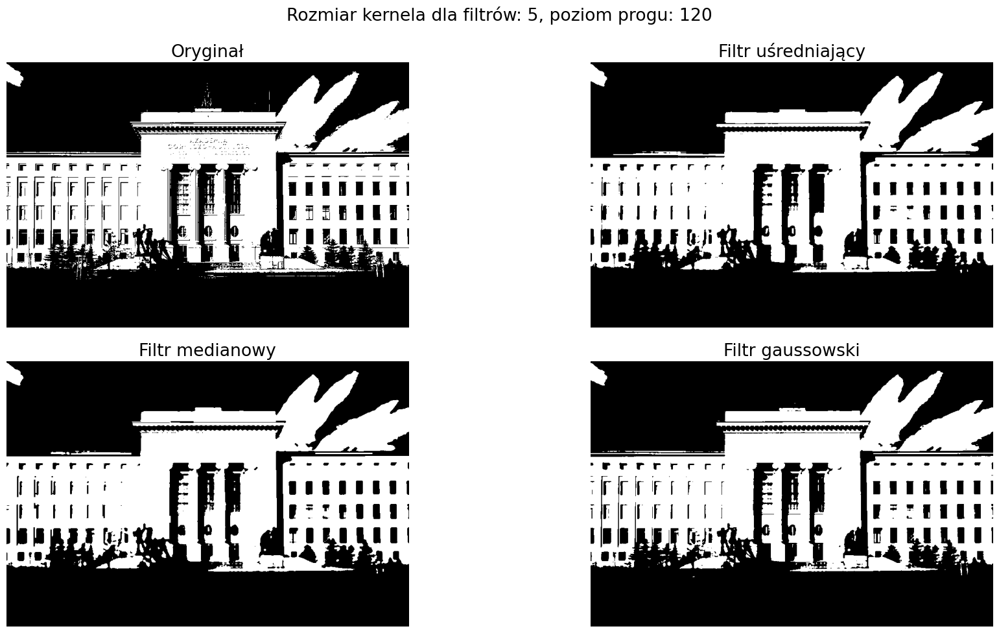

In [9]:
binary_filters(image, 5, 120)

Dla obrazów zbinaryzowanych po filtrowaniu obserwujemy brak pozostałości po napisie na fasadzie jak i po konturach rzeźby na szczycie oraz szczegółach przy oknach. Zastosowanie filtrów przed binaryzają może być pomocne przy przygotowywaniu obrazu do późniejszego wykrywaniu na nim elemetów, gdzie nie potrzebujemy szczegółów.

**g) Proszę nałożyć na obraz filtry Roberts cross, Prewitta i Sobela.**

In [10]:
#stworzenie filtrów
roberts_cross_y = np.array([[0, 1], [-1, 0]])
roberts_cross_x = np.array([[1, 0], [0, -1]])

prewitt_y = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
prewitt_x = prewitt_y.T

sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])
sobel_x = sobel_y.T

#przygotowanie obrazu w skali szarosci
bin_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)


In [11]:
#funkcja pomocnicza - nakłada na image filtry kernel1 i kernel2 wykrywajace krawedzie
def edge_filter(image, kernel1, kernel2, title):
    im1 = cv2.filter2D(src=image, ddepth=-1, kernel=kernel1)
    im2 = cv2.filter2D(src=image, ddepth=-1, kernel=kernel2)

    
    images = [im1, im2, im1+im2, im1+im2]
    cmaps = ['gray', 'gray', 'gray', 'gray_r']
    titles = ['Oś Y', 'Oś X', 'Zsumowane przefiltrowane obrazy', 
             'Zsumowane obrazy - odwrócone kolory']
    count = len(images)
    
    for i in range(count):
        plt.subplot(2, 2, i+1)
        plt.imshow(images[i], cmap=cmaps[i])
        plt.axis('off')
        plt.title(titles[i])

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()
    

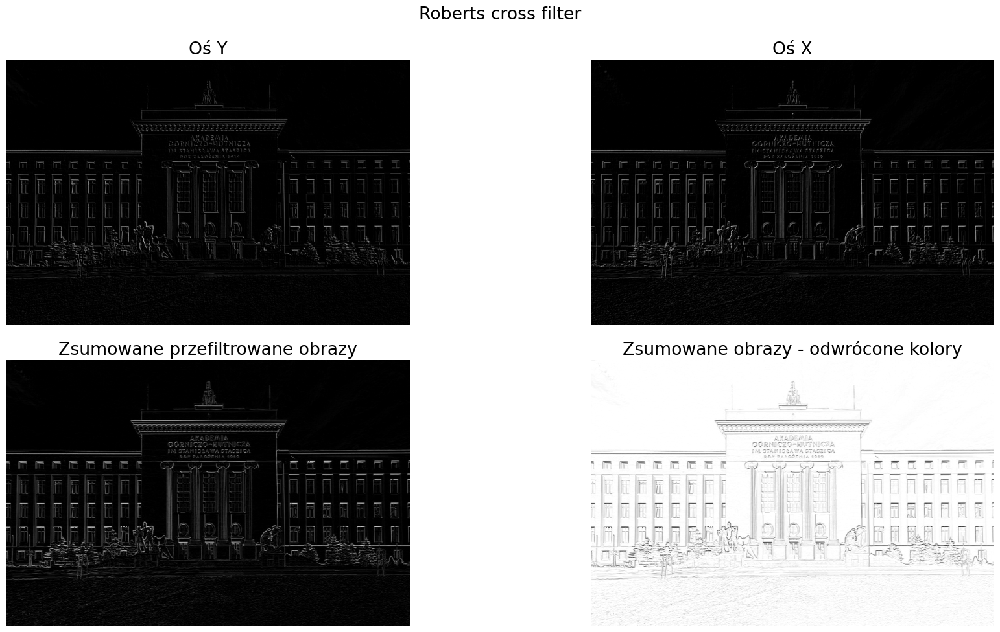

In [12]:
edge_filter(bin_image, roberts_cross_y, roberts_cross_x, 'Roberts cross filter')

Filtry typu krzyż Robertsa są zdefiniowane następująco:

$$ Ox: \begin{bmatrix}
0 & 1 \\
-1 & 0 
\end{bmatrix} 
$$

$$
Oy: 
\begin{bmatrix}
1 & 0 \\
0 & -1 
\end{bmatrix}
$$

Na przykładzie widzimy cienkie krawędzie znalezione dzięki użyciu tych filtrów. Po dodaniu wyników obu operacji (i odwróceniu mapy kolorów) widzimy obraz niczym cienko obrysowany ołówkiem - co poza zastosowaniem wykrywania krawędzi w obróbce obrazów może być cenionym efektem estetycznym. Podobny efekt wcześniej wystąpił przy progowaniu adaptacyjnym, jednak nie otrzymaliśmy wtedy aż tak 'czystych' krawędzi.

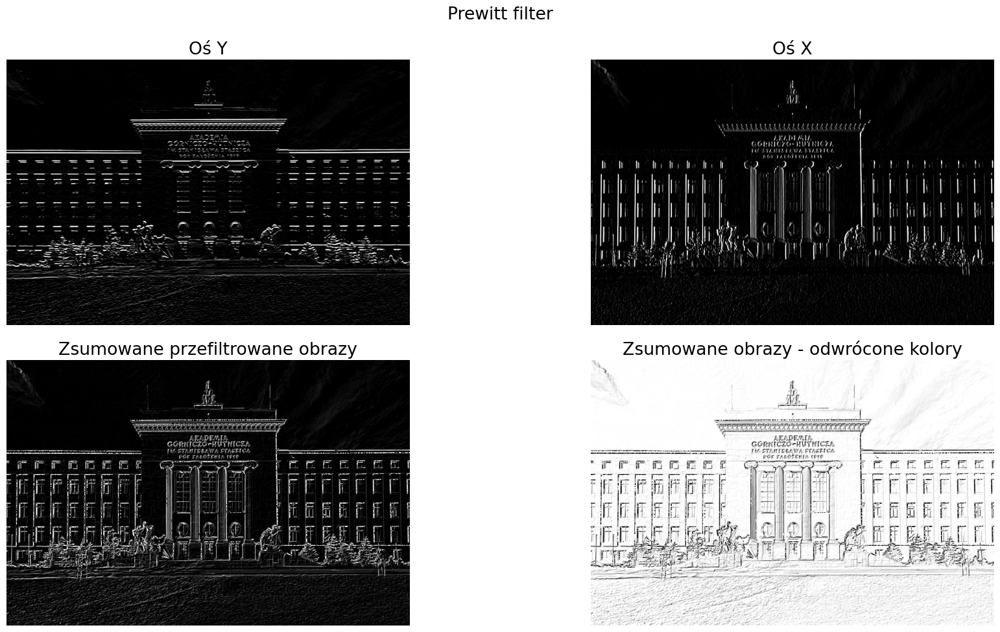

In [13]:
edge_filter(bin_image, prewitt_y, prewitt_x, 'Prewitt filter')

Filtr Prewitta dla osi Oy ma następującą postać:
$$ \begin{bmatrix}
1 & 1 & 1 \\
0 & 0 & 0 \\
-1 & -1 & -1 
\end{bmatrix}  $$
Dla osi Ox jest to filtr dla osi Oy transponowany. W porównaniu do poprzedniego, więcej szczegółów jest odzwierciedlonych - jak chmury, trawa, elementy drzew i rzeźb. 

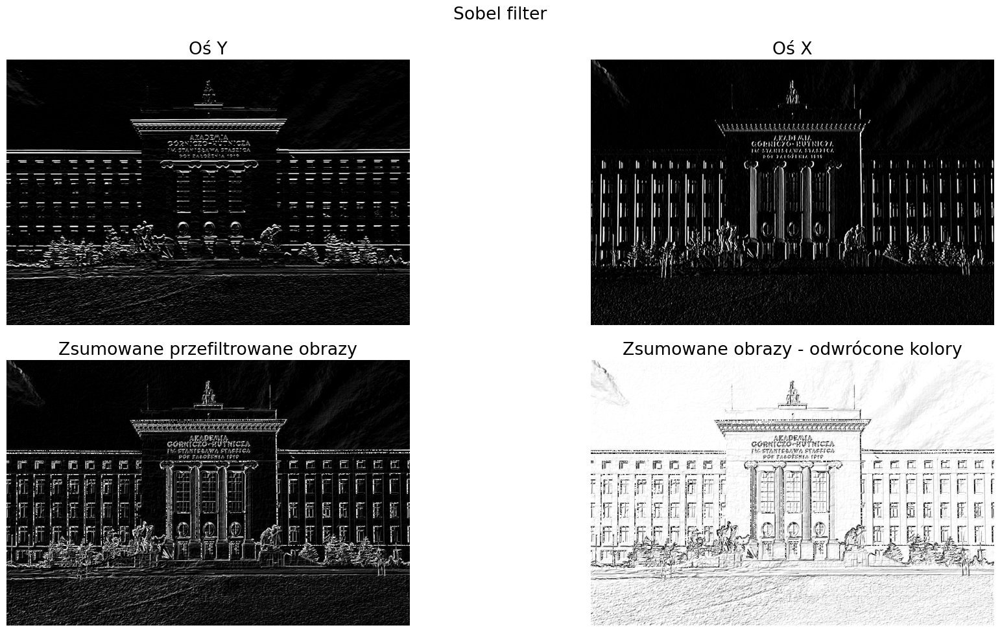

In [14]:
edge_filter(bin_image, sobel_y, sobel_x, 'Sobel filter')

Filtr Sobela dla osi Oy to:

$$ \begin{bmatrix}
1 & 2 & 1 \\
0 & 0 & 0 \\
-1 & -2 & -1 
\end{bmatrix}  $$

Analogicznie jak poprzednio, filtr dla Ox otrzymamy po  transpozycji. Tak jak filtr Sobela uchwycone jest więcej krawędzi, niektóre elementy są widoczne jeszcze lepiej (tekstura fasady budynku). W przypadku potrzeby wykrywania brzegów należy więc zdecydować co będziemy chcieli mieć widoczne - w tym wypadku tekstura budynku lub detale trawniku przed nim mogą być już dla nas zdędne lub przeszkadzające w dalszej analizie.